In [2]:
import pandas as pd
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import ParameterGrid,  train_test_split, StratifiedShuffleSplit
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.svm import SVC 
import xgboost
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.exceptions import ConvergenceWarning

In [11]:
df = pd.read_csv("/Users/jordankavishe/Desktop/semester5/data1030/midterm/data/support2.csv")
df.head()

,age,death,sex,hospdead,slos,d.time,dzgroup,dzclass,num.co,edu,...,crea,sod,ph,glucose,bun,urine,adlp,adls,sfdm2,adlsc
1,62.84998,0,male,0,5,2029,Lung Cancer,Cancer,0,11.0,...,1.199951,141.0,7.459961,NaN,NaN,NaN,7.0,7.0,NaN,7.0
2,60.33899,1,female,1,4,4,Cirrhosis,COPD/CHF/Cirrhosis,2,12.0,...,5.500000,132.0,7.250000,NaN,NaN,NaN,NaN,1.0,<2 mo. follow-up,1.0
3,52.74698,1,female,0,17,47,Cirrhosis,COPD/CHF/Cirrhosis,2,12.0,...,2.000000,134.0,7.459961,NaN,NaN,NaN,1.0,0.0,<2 mo. follow-up,0.0
4,42.38498,1,female,0,3,133,Lung Cancer,Cancer,2,11.0,...,0.799927,139.0,NaN,NaN,NaN,NaN,0.0,0.0,no(M2 and SIP pres),0.0
5,79.88495,0,female,0,16,2029,ARF/MOSF w/Sepsis,ARF/MOSF,1,NaN,...,0.799927,143.0,7.509766,NaN,NaN,NaN,NaN,2.0,no(M2 and SIP pres),2.0


In [6]:
#Functions to use
def find_nulls(dataframe : pd.DataFrame, n : int):
    '''Function that gives you all the features that have more than n missing instances'''
    null_series = dataframe.isnull().sum().where(lambda x: x > n).dropna()
    return null_series

def find_null_ints(dataframe : pd.DataFrame, n : int):
    '''Function that gives you all the features that have exactly n missing instances'''
    null_series_int = dataframe.isnull().sum().where(lambda x: x == n).dropna()
    null_series_int_list = null_series_int.index.to_list()
    return null_series_int, null_series_int_list

def plot_dists(feature_to_plot):
    plt.figure(figsize=(10, 6))
    sns.histplot(df[feature_to_plot], bins=50, kde=True)
    plt.title(f'Distribution of {feature_to_plot}')
    plt.xlabel(f'{feature_to_plot}')
    plt.ylabel('Frequency')
    plt.show()

def unique_vals_all(df):
    df_objects = df.dtypes.where(lambda x: x == 'object').dropna().index.to_list()
    for o in df_objects:
        print(f"{o} unique values: {df[o].unique()}")

def confusion_matrix_plots(model, y_true, y_pred):

    cm = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(cm)
    disp.plot()
    plt.title(f'{model} (No Cross Validation) Best Model Confusion Matrix')
    plt.show()

    cm_percent = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    fig, ax = plt.subplots(figsize=(8, 8))
    sns.heatmap(cm_percent, annot=True, fmt=".2%", cmap='Blues', square=True, ax=ax)

    label_names = np.unique(y_true) 
    ax.set_xlabel('Predicted labels')
    ax.set_ylabel('True labels')
    ax.set_title(f'{model} (No CV) Best Model % Confusion Matrix')
    ax.xaxis.set_ticklabels(label_names)
    ax.yaxis.set_ticklabels(label_names)
    plt.show()
    

# Handling Missing Data

In [7]:
print(df.shape)

extreme_null_df = df.dropna() # Dataframe if you dropped ALL missing value
print(extreme_null_df.shape)

(9105, 47)
(306, 47)


In [8]:
null_df = df[df.isnull().any(axis=1)]
print(f"Percentage of rows with at least one missing value: {null_df.shape[0] / df.shape[0]}")

null_features = find_nulls(df, 0).index.to_list()
print(f"There are {len(null_features)} features with at least one missing values. \n These features are: {null_features}")

# Percentage of each feature that are missing
missing_feature_percentages = {}
for n in null_features:
    null_percent = null_df[null_df[n].isnull()].shape[0] / df.shape[0]
    missing_feature_percentages[n] =  null_percent
    print(f"Percentage of {n} features missing: {null_percent}")

Percentage of rows with at least one missing value: 0.9663920922570016
There are 33 features with at least one missing values. 
 These features are: ['edu', 'income', 'scoma', 'charges', 'totcst', 'totmcst', 'avtisst', 'race', 'sps', 'aps', 'surv2m', 'surv6m', 'prg2m', 'prg6m', 'dnr', 'dnrday', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi', 'alb', 'bili', 'crea', 'sod', 'ph', 'glucose', 'bun', 'urine', 'adlp', 'adls', 'sfdm2']
Percentage of edu features missing: 0.17946183415705655
Percentage of income features missing: 0.3275123558484349
Percentage of scoma features missing: 0.00010982976386600769
Percentage of charges features missing: 0.018890719384953323
Percentage of totcst features missing: 0.09752883031301483
Percentage of totmcst features missing: 0.3816584294343767
Percentage of avtisst features missing: 0.00900604063701263
Percentage of race features missing: 0.004612850082372323
Percentage of sps features missing: 0.00010982976386600769
Percentage of aps features missing: 

In [12]:
# Drop all the features with only one missing values
null_ones = df.isnull().sum().where(lambda x: x == 1).dropna().index.to_list()
df.dropna(subset=null_ones, inplace=True)
print(df.shape)

# Drop all the rows with in features less than 100 missing values
null_greater_than_one = find_nulls(df, 0).where(lambda x: x < 100).dropna().index.to_list()
df.dropna(subset=null_greater_than_one, inplace=True)
print(df.shape)

df.dropna(subset=['income', 'edu', 'charges', 'sfdm2'], inplace=True)

values = {'alb': 3.5, 'pafi' : 333.3, 'bili' : 1.01, 'crea' : 1.01, 'bun' : 6.51, 'wblc' : 9, 'urine' : 2502, 'ph' : 7.415534, 
          'glucose' : 159.640000, 'adlp' : 1.162239, 'adls' : 1.621342, 'totcst' : 30241.998476, 'totmcst': 12646.000000, 'prg2m' : 0.700000, 'prg6m' :0.500000}
df.fillna(value=values, inplace=True)
print(df.shape)

(9103, 47)
(8888, 47)
(5049, 47)


# Model Training

#### Logistic Regression

In [24]:
y = df['hospdead']
X = df.loc[:, df.columns != 'hospdead']
final_models_log_no_cv = []

nr_states = 5
test_scores_log_no_cv = np.zeros(nr_states)

y_true_cm_log_no_cv = []  
y_pred_cm_log_no_cv = []

for i in range(nr_states):
    X_other, X_test, y_other, y_test = train_test_split(X, y, test_size=0.3, random_state=i, stratify=y)
    X_train, X_val, y_train, y_val = train_test_split(X_other, y_other, train_size=0.5, random_state=i, stratify=y_other)

    ordinal_ftrs = ['income'] 
    ordinal_cats = [['under $11k', '$25-$50k', '$11-$25k', '>$50k']]
    onehot_ftrs = ['sex', 'dzgroup', 'dzclass', 'race', 'ca', 'dnr']
    std_ftrs = ['age', 'slos', 'd.time', 'charges', 'totcst', 'totmcst', 'avtisst', 'sps', 'aps', 
                'surv2m', 'surv6m', 'hday', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi', 'alb', 
                'bili', 'crea', 'sod', 'glucose', 'bun', 'urine', 'adlsc']

    preprocessor = ColumnTransformer(
        transformers=[
            ('ord', OrdinalEncoder(categories=ordinal_cats), ordinal_ftrs),
            ('onehot', OneHotEncoder(sparse_output=False, handle_unknown='ignore'), onehot_ftrs),
            ('std', StandardScaler(), std_ftrs)])

    prep = Pipeline(steps=[('preprocessor', preprocessor)]) 

    X_train_prep = prep.fit_transform(X_train)
    X_val_prep = prep.transform(X_val)
    X_test_prep = prep.transform(X_test)

    param_grid = {
        'penalty': ['l1', 'l2', 'elasticnet', 'none'],
        'C': np.logspace(-4, 4, 20),
        'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
        'l1_ratio': np.linspace(0, 1, 10) 
    }

    train_score = []
    val_score = []
    models = []

    for p, params in enumerate(ParameterGrid(param_grid)):
        # Compatibility check
        if params['solver'] in ['liblinear', 'saga'] or params['penalty'] in ['l2', 'none']:
            if params['penalty'] == 'elasticnet' and params['solver'] != 'saga':
                continue
            if params['penalty'] != 'elasticnet' and 'l1_ratio' in params:
                continue

            print('   ', params) 

            with warnings.catch_warnings():
                warnings.filterwarnings("ignore", category=ConvergenceWarning)

                try:
                    clf = LogisticRegression(**params, random_state=i, max_iter=10000)
                    clf.fit(X_train_prep, y_train)
                except ValueError as e:
                    print("Error:", e)
                    continue

                models.append(clf)
                y_train_pred = clf.predict(X_train_prep)
                train_score.append(accuracy_score(y_train, y_train_pred))
                y_val_pred = clf.predict(X_val_prep)
                val_score.append(accuracy_score(y_val, y_val_pred))
                print('   ', train_score[-1], val_score[-1])
        else:
            continue

    if val_score:
        best_model_index = np.argmax(val_score)
        print('best model parameters:', models[best_model_index].get_params())
        print('corresponding validation score:', val_score[best_model_index])

        final_models_log_no_cv.append(models[best_model_index])
        y_test_pred = final_models_log_no_cv[-1].predict(X_test_prep)
        test_scores_log_no_cv[i] = accuracy_score(y_test, y_test_pred)
        
        print('test score:', test_scores_log_no_cv[i])

        #calculate for future confusion matrix
        y_true_cm_log_no_cv.extend(y_test.tolist())
        y_pred_cm_log_no_cv.extend(y_test_pred.tolist())
    else:
        print(f"No valid model found for state {i}")

print("Average Test Score:", np.mean(test_scores_log_no_cv))
print("Standard Deviation of Test Scores:", np.std(test_scores_log_no_cv))


    {'C': 0.0001, 'l1_ratio': 0.0, 'penalty': 'elasticnet', 'solver': 'saga'}
    0.7436332767402377 0.7430673457838144
    {'C': 0.0001, 'l1_ratio': 0.1111111111111111, 'penalty': 'elasticnet', 'solver': 'saga'}
    0.7436332767402377 0.7430673457838144
    {'C': 0.0001, 'l1_ratio': 0.2222222222222222, 'penalty': 'elasticnet', 'solver': 'saga'}
    0.7436332767402377 0.7430673457838144
    {'C': 0.0001, 'l1_ratio': 0.3333333333333333, 'penalty': 'elasticnet', 'solver': 'saga'}
    0.7436332767402377 0.7430673457838144
    {'C': 0.0001, 'l1_ratio': 0.4444444444444444, 'penalty': 'elasticnet', 'solver': 'saga'}
    0.7436332767402377 0.7430673457838144
    {'C': 0.0001, 'l1_ratio': 0.5555555555555556, 'penalty': 'elasticnet', 'solver': 'saga'}
    0.7436332767402377 0.7430673457838144
    {'C': 0.0001, 'l1_ratio': 0.6666666666666666, 'penalty': 'elasticnet', 'solver': 'saga'}
    0.7436332767402377 0.7430673457838144
    {'C': 0.0001, 'l1_ratio': 0.7777777777777777, 'penalty': 'elasticn

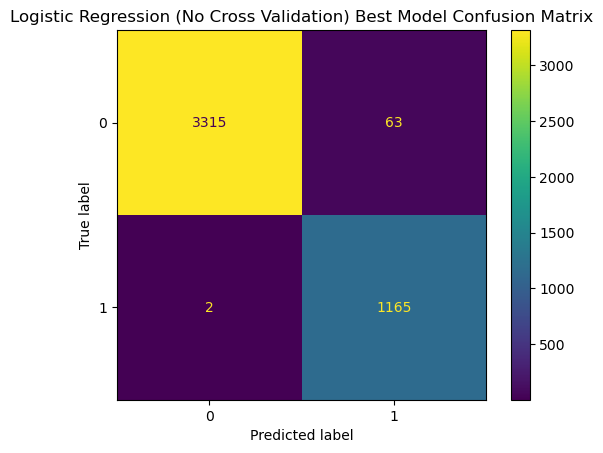

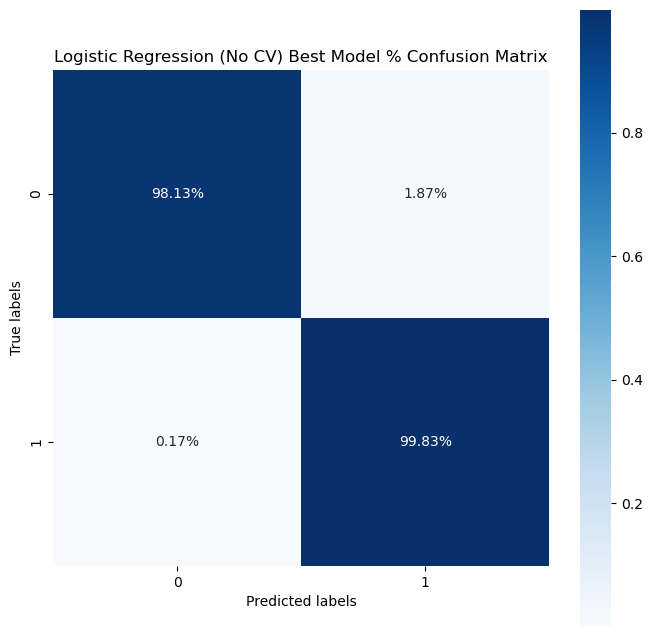

In [34]:
confusion_matrix_plots('Logistic Regression', y_true_cm_log_no_cv, y_pred_cm_log_no_cv)

#### Random Forest Classifier

In [58]:
y = df['hospdead']
X = df.loc[:, df.columns != 'hospdead']
final_models_rfc_no_cv = []

nr_states = 3
test_scores_rfc_no_cv = np.zeros(nr_states)

y_true_cm_rfc_no_cv = []  
y_pred_cm_rfc_no_cv = []

for i in range(nr_states):
    X_other, X_test, y_other, y_test = train_test_split(X, y, test_size=0.3, random_state=i, stratify=y)
    X_train, X_val, y_train, y_val = train_test_split(X_other,y_other,train_size = 0.5, random_state=i, stratify=y_other)

    ordinal_ftrs = ['income'] 
    ordinal_cats = [['under $11k', '$25-$50k', '$11-$25k', '>$50k']]
    onehot_ftrs = ['sex', 'dzgroup', 'dzclass', 'race', 'ca', 'dnr']
    std_ftrs = ['age', 'slos', 'd.time', 'charges', 'totcst', 'totmcst', 'avtisst', 'sps', 'aps', 
                'surv2m', 'surv6m', 'hday', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi', 'alb', 
                'bili', 'crea', 'sod', 'glucose', 'bun', 'urine', 'adlsc']

    preprocessor = ColumnTransformer(
        transformers=[
            ('ord', OrdinalEncoder(categories = ordinal_cats), ordinal_ftrs),
            ('onehot', OneHotEncoder(sparse_output=False,handle_unknown='ignore'), onehot_ftrs),
            ('std', StandardScaler(), std_ftrs)])

    prep = Pipeline(steps=[('preprocessor', preprocessor)]) 

    X_train_prep = prep.fit_transform(X_train)
    X_val_prep = prep.transform(X_val)
    X_test_prep = prep.transform(X_test)

    param_grid = {
    'n_estimators': [100, 300, 4500],
    'max_features': ['sqrt', 'log2', 0.2, 0.5, 0.8],
    'max_depth': [None, 10, 30, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False],
    'criterion': ['gini', 'entropy']
    }
    
    train_score = np.zeros(len(ParameterGrid(param_grid)))
    val_score = np.zeros(len(ParameterGrid(param_grid)))
    models = []

    for p in range(len(ParameterGrid(param_grid))):
        params = ParameterGrid(param_grid)[p]
        print('   ',params)         
        clf = RandomForestClassifier(**params,random_state = i,n_jobs=-1) 
        clf.fit(X_train_prep,y_train) 
        models.append(clf) 

        y_train_pred = clf.predict(X_train_prep)
        train_score[p] = accuracy_score(y_train,y_train_pred)
        y_val_pred = clf.predict(X_val_prep)
        val_score[p] = accuracy_score(y_val,y_val_pred)
        print('   ',train_score[p],val_score[p])

    print('best model parameters:',ParameterGrid(param_grid)[np.argmax(val_score)])
    print('corresponding validation score:',np.max(val_score))

    final_models_rfc_no_cv.append(models[np.argmax(val_score)])
    
    y_test_pred = final_models_rfc_no_cv[-1].predict(X_test_prep)
    test_scores_rfc_no_cv[i] = accuracy_score(y_test,y_test_pred)
    print('test score:',test_scores_rfc_no_cv[i])

    y_true_cm_rfc_no_cv.extend(y_test.tolist())
    y_pred_cm_rfc_no_cv.extend(y_test_pred.tolist())

print("Average Test Score:", np.mean(test_scores_rfc_no_cv))
print("Standard Deviation of Test Scores:", np.std(test_scores_rfc_no_cv))

    {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'gini', 'bootstrap': True}
    1.0 0.9575551782682513
    {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'gini', 'bootstrap': True}
    1.0 0.9592529711375212
    {'n_estimators': 300, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'gini', 'bootstrap': True}
    1.0 0.9564233163554047
    {'n_estimators': 400, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'gini', 'bootstrap': True}
    1.0 0.9581211092246746
    {'n_estimators': 500, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'gini', 'bootstrap': True}
    1.0 0.9581211092246746
    {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_feature

#### Decision Tree Classifier

In [16]:
y = df['hospdead']
X = df.loc[:, df.columns != 'hospdead']
random_state = 42
final_models_dt_no_cv = []

nr_states = 3
test_scores_dt_no_cv = np.zeros(nr_states)

y_true_cm_dt_cv = []  
y_pred_cm_dt_cv = []

for i in range(nr_states):
    X_other, X_test, y_other, y_test = train_test_split(X, y, test_size=0.3, random_state=i, stratify=y)
    X_train, X_val, y_train, y_val = train_test_split(X_other,y_other,train_size = 0.5, random_state=i, stratify=y_other)

    ordinal_ftrs = ['income'] 
    ordinal_cats = [['under $11k', '$25-$50k', '$11-$25k', '>$50k']]
    onehot_ftrs = ['sex', 'dzgroup', 'dzclass', 'race', 'ca', 'dnr']
    std_ftrs = ['age', 'slos', 'd.time', 'charges', 'totcst', 'totmcst', 'avtisst', 'sps', 'aps', 
                'surv2m', 'surv6m', 'hday', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi', 'alb', 
                'bili', 'crea', 'sod', 'glucose', 'bun', 'urine', 'adlsc']

    preprocessor = ColumnTransformer(
        transformers=[
            ('ord', OrdinalEncoder(categories = ordinal_cats), ordinal_ftrs),
            ('onehot', OneHotEncoder(sparse_output=False,handle_unknown='ignore'), onehot_ftrs),
            ('std', StandardScaler(), std_ftrs)])

    prep = Pipeline(steps=[('preprocessor', preprocessor)]) 

    X_train_prep = prep.fit_transform(X_train)
    X_val_prep = prep.transform(X_val)
    X_test_prep = prep.transform(X_test)

    param_grid = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 30, 50],
    'min_samples_split': range(2, 10),
    'min_samples_leaf': range(1, 5),
    'max_features': ['sqrt', 'log2', None],
    'max_leaf_nodes': [None, 10, 30, 50],
    'min_impurity_decrease': [0, 0.01, 0.1]
    }

    train_score = np.zeros(len(ParameterGrid(param_grid)))
    val_score = np.zeros(len(ParameterGrid(param_grid)))
    models = []

    for p in range(len(ParameterGrid(param_grid))):
        params = ParameterGrid(param_grid)[p]
        print('   ',params)         
        clf = DecisionTreeClassifier(**params,random_state = i) 
        clf.fit(X_train_prep,y_train) 
        models.append(clf) 

        y_train_pred = clf.predict(X_train_prep)
        train_score[p] = accuracy_score(y_train,y_train_pred)
        y_val_pred = clf.predict(X_val_prep)
        val_score[p] = accuracy_score(y_val,y_val_pred)
        print('   ',train_score[p],val_score[p])

    print('best model parameters:',ParameterGrid(param_grid)[np.argmax(val_score)])
    print('corresponding validation score:',np.max(val_score))
    final_models_dt_no_cv.append(models[np.argmax(val_score)])
    y_test_pred = final_models_dt_no_cv[-1].predict(X_test_prep)
    test_scores_dt_no_cv[i] = accuracy_score(y_test,y_test_pred)
    print('test score:',test_scores_dt_no_cv[i])

    y_true_cm_dt_cv.extend(y_test.tolist())
    y_pred_cm_dt_cv.extend(y_test_pred.tolist())

print("Average Test Score:", np.mean(test_scores_dt_no_cv))
print("Standard Deviation of Test Scores:", np.std(test_scores_dt_no_cv))

    {'splitter': 'best', 'min_samples_split': 2, 'min_samples_leaf': 1, 'min_impurity_decrease': 0, 'max_leaf_nodes': None, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'gini'}
    1.0 0.9173740803621958
    {'splitter': 'random', 'min_samples_split': 2, 'min_samples_leaf': 1, 'min_impurity_decrease': 0, 'max_leaf_nodes': None, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'gini'}
    1.0 0.8477645727221279
    {'splitter': 'best', 'min_samples_split': 3, 'min_samples_leaf': 1, 'min_impurity_decrease': 0, 'max_leaf_nodes': None, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'gini'}
    0.9954725523486134 0.9145444255800792
    {'splitter': 'random', 'min_samples_split': 3, 'min_samples_leaf': 1, 'min_impurity_decrease': 0, 'max_leaf_nodes': None, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'gini'}
    0.9858517260894171 0.8409734012450482
    {'splitter': 'best', 'min_samples_split': 4, 'min_samples_leaf': 1, 'min_impurity_decrease': 0, 'max_l

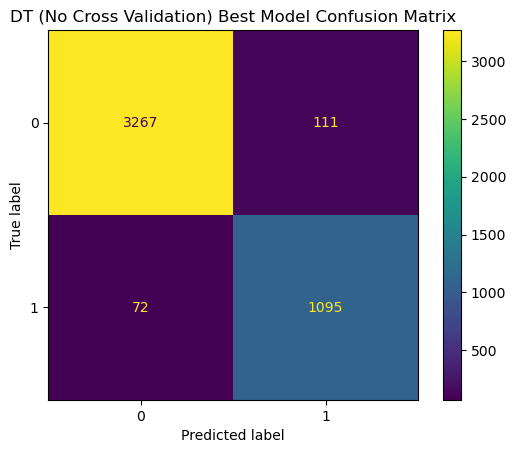

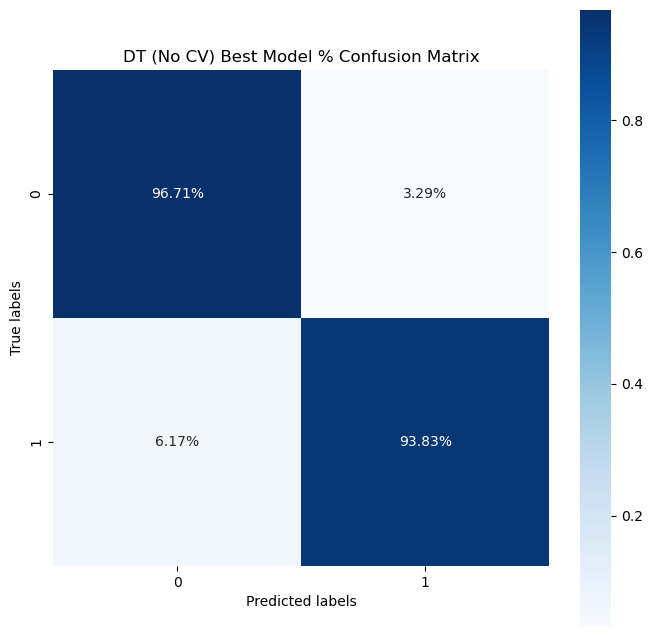

In [35]:
confusion_matrix_plots('DT', y_true_cm_dt_cv, y_pred_cm_dt_cv)

#### Support Vector Classifier

In [39]:
y = df['hospdead']
X = df.loc[:, df.columns != 'hospdead']
final_models_svc_no_cv = []

nr_states = 3
test_scores_svc_no_cv = np.zeros(nr_states)

y_true_cm_svc_no_cv = []  
y_pred_cm_svc_no_cv = []

for i in range(nr_states):
    X_other, X_test, y_other, y_test = train_test_split(X, y, test_size=0.3, random_state=i, stratify=y)
    X_train, X_val, y_train, y_val = train_test_split(X_other,y_other,train_size = 0.5, random_state=i, stratify=y_other)

    ordinal_ftrs = ['income'] 
    ordinal_cats = [['under $11k', '$25-$50k', '$11-$25k', '>$50k']]
    onehot_ftrs = ['sex', 'dzgroup', 'dzclass', 'race', 'ca', 'dnr']
    std_ftrs = ['age', 'slos', 'd.time', 'charges', 'totcst', 'totmcst', 'avtisst', 'sps', 'aps', 
                'surv2m', 'surv6m', 'hday', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi', 'alb', 
                'bili', 'crea', 'sod', 'glucose', 'bun', 'urine', 'adlsc']

    preprocessor = ColumnTransformer(
        transformers=[
            ('ord', OrdinalEncoder(categories = ordinal_cats), ordinal_ftrs),
            ('onehot', OneHotEncoder(sparse_output=False,handle_unknown='ignore'), onehot_ftrs),
            ('std', StandardScaler(), std_ftrs)])

    prep = Pipeline(steps=[('preprocessor', preprocessor)]) 

    X_train_prep = prep.fit_transform(X_train)
    X_val_prep = prep.transform(X_val)
    X_test_prep = prep.transform(X_test)

    param_grid = {
    'C': [0.1, 1, 10, 100, 1000],
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'degree': [2, 3, 4],
    'gamma': ['scale', 'auto', 0.001, 0.01, 0.1, 1],
    'coef0': [0, 0.5, 1]
    }

    train_score = np.zeros(len(ParameterGrid(param_grid)))
    val_score = np.zeros(len(ParameterGrid(param_grid)))
    models = []

    for p in range(len(ParameterGrid(param_grid))):
        params = ParameterGrid(param_grid)[p]
        print('   ',params)         
        clf = SVC(**params,random_state = i) 
        clf.fit(X_train_prep,y_train) 
        models.append(clf) 

        y_train_pred = clf.predict(X_train_prep)
        train_score[p] = accuracy_score(y_train,y_train_pred)
        y_val_pred = clf.predict(X_val_prep)
        val_score[p] = accuracy_score(y_val,y_val_pred)
        print('   ',train_score[p],val_score[p])

    print('best model parameters:',ParameterGrid(param_grid)[np.argmax(val_score)])
    print('corresponding validation score:',np.max(val_score))
    final_models_svc_no_cv.append(models[np.argmax(val_score)])
    y_test_pred = final_models_svc_no_cv[-1].predict(X_test_prep)
    test_scores_svc_no_cv[i] = accuracy_score(y_test,y_test_pred)
    print('test score:',test_scores_svc_no_cv[i])

    y_true_cm_svc_no_cv.extend(y_test.tolist())
    y_pred_cm_svc_no_cv.extend(y_test_pred.tolist())

print("Average Test Score:", np.mean(test_scores_svc_no_cv))
print("Standard Deviation of Test Scores:", np.std(test_scores_svc_no_cv))

    {'kernel': 'linear', 'gamma': 'scale', 'degree': 2, 'coef0': 0, 'C': 0.1}
    0.9309564233163554 0.923033389926429
    {'kernel': 'poly', 'gamma': 'scale', 'degree': 2, 'coef0': 0, 'C': 0.1}
    0.8726655348047538 0.8590831918505942
    {'kernel': 'rbf', 'gamma': 'scale', 'degree': 2, 'coef0': 0, 'C': 0.1}
    0.8970005659309565 0.8828522920203735
    {'kernel': 'sigmoid', 'gamma': 'scale', 'degree': 2, 'coef0': 0, 'C': 0.1}
    0.9088851160158461 0.9020939445387662
    {'kernel': 'linear', 'gamma': 'auto', 'degree': 2, 'coef0': 0, 'C': 0.1}
    0.9309564233163554 0.923033389926429
    {'kernel': 'poly', 'gamma': 'auto', 'degree': 2, 'coef0': 0, 'C': 0.1}
    0.8279569892473119 0.8189020939445387
    {'kernel': 'rbf', 'gamma': 'auto', 'degree': 2, 'coef0': 0, 'C': 0.1}
    0.9015280135823429 0.8868138087153368
    {'kernel': 'sigmoid', 'gamma': 'auto', 'degree': 2, 'coef0': 0, 'C': 0.1}
    0.9037917374080362 0.88907753254103
    {'kernel': 'linear', 'gamma': 0.001, 'degree': 2, 'c

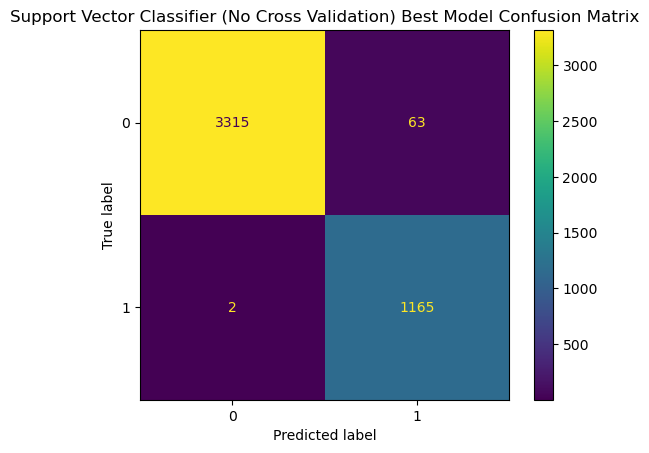

In [40]:
svc_no_cv_cm = confusion_matrix(y_true_cm_svc_no_cv, y_pred_cm_svc_no_cv)
disp = ConfusionMatrixDisplay(svc_no_cv_cm)
disp.plot()
plt.title('Support Vector Classifier (No Cross Validation) Best Model Confusion Matrix')
plt.show()

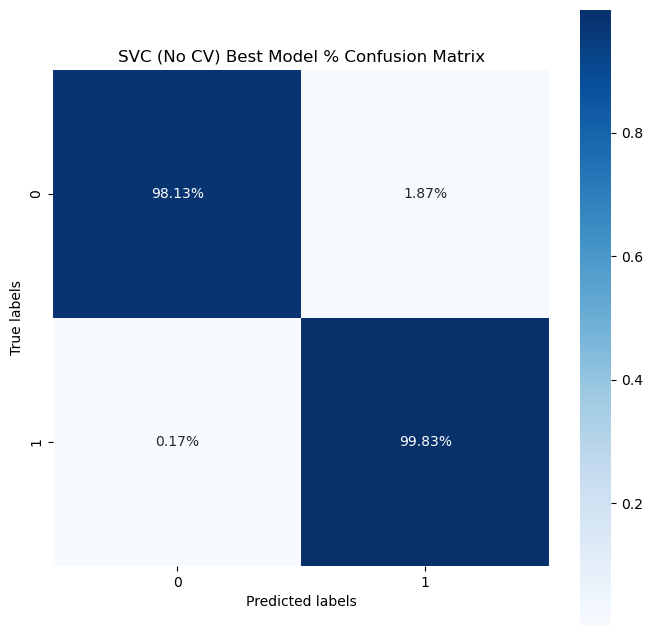

In [49]:
cm_percent = svc_no_cv_cm.astype('float') / svc_no_cv_cm.sum(axis=1)[:, np.newaxis]

fig, ax = plt.subplots(figsize=(8, 8))
sns.heatmap(cm_percent, annot=True, fmt=".2%", cmap='Blues', square=True, ax=ax)

label_names = np.unique(y_true_cm_svc_no_cv) #
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('SVC (No CV) Best Model % Confusion Matrix')
ax.xaxis.set_ticklabels(label_names)
ax.yaxis.set_ticklabels(label_names)
plt.show()

#### XGBoost Classifier

In [61]:
y = df['hospdead']
X = df.loc[:, df.columns != 'hospdead']
final_models_xgbc_no_vc = []

nr_states = 3
test_scores_xgbc_no_vc = np.zeros(nr_states)

y_true_cm = []  
y_pred_cm = []

for i in range(nr_states):
    X_other, X_test, y_other, y_test = train_test_split(X, y, test_size=0.3, random_state=i, stratify=y)
    X_train, X_val, y_train, y_val = train_test_split(X_other,y_other,train_size = 0.5, random_state=i, stratify=y_other)

    ordinal_ftrs = ['income'] 
    ordinal_cats = [['under $11k', '$25-$50k', '$11-$25k', '>$50k']]
    onehot_ftrs = ['sex', 'dzgroup', 'dzclass', 'race', 'ca', 'dnr']
    std_ftrs = ['age', 'slos', 'd.time', 'charges', 'totcst', 'totmcst', 'avtisst', 'sps', 'aps', 
                'surv2m', 'surv6m', 'hday', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi', 'alb', 
                'bili', 'crea', 'sod', 'glucose', 'bun', 'urine', 'adlsc']

    # collect all the encoders into one preprocessor
    preprocessor = ColumnTransformer(
        transformers=[
            ('ord', OrdinalEncoder(categories = ordinal_cats), ordinal_ftrs),
            ('onehot', OneHotEncoder(sparse_output=False,handle_unknown='ignore'), onehot_ftrs),
            ('std', StandardScaler(), std_ftrs)])

    prep = Pipeline(steps=[('preprocessor', preprocessor)]) 

    X_train_prep = prep.fit_transform(X_train)
    X_val_prep = prep.transform(X_val)
    X_test_prep = prep.transform(X_test)

    param_grid = {
    'learning_rate': [0.01, 0.1, 0.2, 0.3],
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'min_child_weight': [1, 3, 5],
    'subsample': [0.6, 0.7, 0.8, 0.9],
    'colsample_bytree': [0.6, 0.7, 0.8, 0.9],
    'gamma': [0, 0.1, 0.2, 0.3, 0.4]
    }

    train_score = np.zeros(len(ParameterGrid(param_grid)))
    val_score = np.zeros(len(ParameterGrid(param_grid)))
    models = []

    for p in range(len(ParameterGrid(param_grid))):
        params = ParameterGrid(param_grid)[p]
        print('   ',params)         
        clf = xgboost.XGBClassifier(**params,random_state = 42*i) 
        clf.fit(X_train_prep,y_train)
        models.append(clf) 

        y_train_pred = clf.predict(X_train_prep)
        train_score[p] = accuracy_score(y_train,y_train_pred)
        y_val_pred = clf.predict(X_val_prep)
        val_score[p] = accuracy_score(y_val,y_val_pred)
        print('   ',train_score[p],val_score[p])

    print('best model parameters:',ParameterGrid(param_grid)[np.argmax(val_score)])
    print('corresponding validation score:',np.max(val_score))
    final_models_xgbc_no_vc.append(models[np.argmax(val_score)])
    y_test_pred = final_models_xgbc_no_vc[-1].predict(X_test_prep)
    test_scores_xgbc_no_vc[i] = accuracy_score(y_test,y_test_pred)
    print('test score:',test_scores_xgbc_no_vc[i])

    y_true_cm.extend(y_test.tolist())
    y_pred_cm.extend(y_test_pred.tolist())

print("Average Test Score:", np.mean(test_scores_xgbc_no_vc))
print("Standard Deviation of Test Scores:", np.std(test_scores_xgbc_no_vc))

    {'subsample': 0.6, 'n_estimators': 100, 'min_child_weight': 1, 'max_depth': 3, 'learning_rate': 0.01, 'gamma': 0, 'colsample_bytree': 0.6}
    0.966044142614601 0.9558573853989814
    {'subsample': 0.7, 'n_estimators': 100, 'min_child_weight': 1, 'max_depth': 3, 'learning_rate': 0.01, 'gamma': 0, 'colsample_bytree': 0.6}
    0.9637804187889077 0.9558573853989814
    {'subsample': 0.8, 'n_estimators': 100, 'min_child_weight': 1, 'max_depth': 3, 'learning_rate': 0.01, 'gamma': 0, 'colsample_bytree': 0.6}
    0.9654782116581777 0.9518958687040181
    {'subsample': 0.9, 'n_estimators': 100, 'min_child_weight': 1, 'max_depth': 3, 'learning_rate': 0.01, 'gamma': 0, 'colsample_bytree': 0.6}
    0.9666100735710244 0.9513299377475948
    {'subsample': 0.6, 'n_estimators': 200, 'min_child_weight': 1, 'max_depth': 3, 'learning_rate': 0.01, 'gamma': 0, 'colsample_bytree': 0.6}
    0.9711375212224108 0.9603848330503678
    {'subsample': 0.7, 'n_estimators': 200, 'min_child_weight': 1, 'max_dept